In [28]:
# This data is freely available on Amazon AWS, so we construct the image using s3fs,
# without having to download any files to our local computer.

# Many thanks to @simon_sat on Twitter

import fsspec
import itertools
from satpy.readers import FSFile

fs = fsspec.filesystem(
    "filecache",
    target_protocol="s3",
    target_options={"anon": True},
    cache_storage="/tmp/satpy",
    same_names=True,
)

# Lots of activity, including some bright coccolithophores 🛰️🦠
# aws s3 sync s3://noaa-nesdis-n20-pds/VIIRS-M3-SDR/2024/05/11/ VIIRS-M3-SDR --exclude "*" --include "*t132*" --no-sign-request

filenames = list(
    FSFile(f, fs=fs)
    for f in itertools.chain(
        *(
            fs.glob(f"s3://noaa-nesdis-n20-pds/{data_type}/2024/05/11/*t114*")
            # fs.glob(f"s3://noaa-nesdis-n20-pds/{data_type}/2024/05/11/*t132*")
            for data_type in [
                "VIIRS-M3-SDR",
                "VIIRS-M4-SDR",
                "VIIRS-M5-SDR",
                "VIIRS-MOD-GEO-TC",
            ]
        )
    )
)

In [29]:
from satpy import Scene

scn = Scene(filenames, reader="viirs_sdr")

In [27]:
# Load the true colour (close to what the human eye sees) image from the three science data types
scn.load(["true_color"])

# By default, the data is in 'satellite projection', which looks somewhat ugly and can't be easily geolocated
# Here we resample the Scene onto an Oblique Mercator projection bounded by the data
scn2 = scn.resample("omerc_bb", resampler="nearest")
scn2.show("true_color")

Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'solar_azimuth_angle'
Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'solar_azimuth_angle'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'i_latitude'


Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'solar_azimuth_angle'
Required file type 'generic_file' not found or loaded for 'satellite_azimuth_angle'
Required file type 'generic_file' not found or loaded for 'satellite_zenith_angle'
Required file type 'generic_file' not found or loaded for 'solar_zenith_angle'
Required file type 'generic_file' not found or loaded for 'I01'


In [94]:
scn.available_composite_names()


[
    'ocean_color',
    'true_color',
    'true_color_crefl',
    'true_color_lowres',
    'true_color_lowres_crefl',
    'true_color_lowres_land',
    'true_color_lowres_marine_tropical',
    'true_color_raw'
]

In [33]:
scn.load(["true_color", "true_color_raw"])

Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'solar_azimuth_angle'
Required file type 'generic_file' not found or loaded for 'i_latitude'


Required file type 'generic_file' not found or loaded for 'solar_azimuth_angle'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'i_latitude'
Required file type 'generic_file' not found or loaded for 'i_longitude'
Required file type 'generic_file' not found or loaded for 'solar_azimuth_angle'
Required file type 'generic_file' not found or loaded for 'satellite_azimuth_angle'
Required file type 'generic_file' not fou

In [37]:
from cartes import crs
from pyresample import get_area_def

lambert = crs.Lambert93()

area_id = "france_lambert93"

# x_size = 1000
# y_size = 800
area_extent = (-250000, 6034306, 1320649, 7235612)
projection = lambert.to_proj4()
description = "France métropolitaine"
proj_id = "lambert93"


# Calculate the width and height of the area extent
width_extent = area_extent[2] - area_extent[0]  # x_max - x_min
height_extent = area_extent[3] - area_extent[1]  # y_max - y_min

# Calculate the aspect ratio
aspect_ratio = width_extent / height_extent

# Set y_size and adjust x_size to maintain the correct aspect ratio
y_size = 800  # Desired height in pixels
x_size = int(y_size * aspect_ratio)  # Adjust x_size to maintain the aspect ratio


my_area = get_area_def(
    area_id, description, proj_id, projection, x_size, y_size, area_extent
)

new_scn = scn.resample(my_area)


In [38]:
%config InlineBackend.figure_format='retina'

In [41]:
new_scn.save_dataset("true_color", filename="contrails.jpg", fill_value=0)

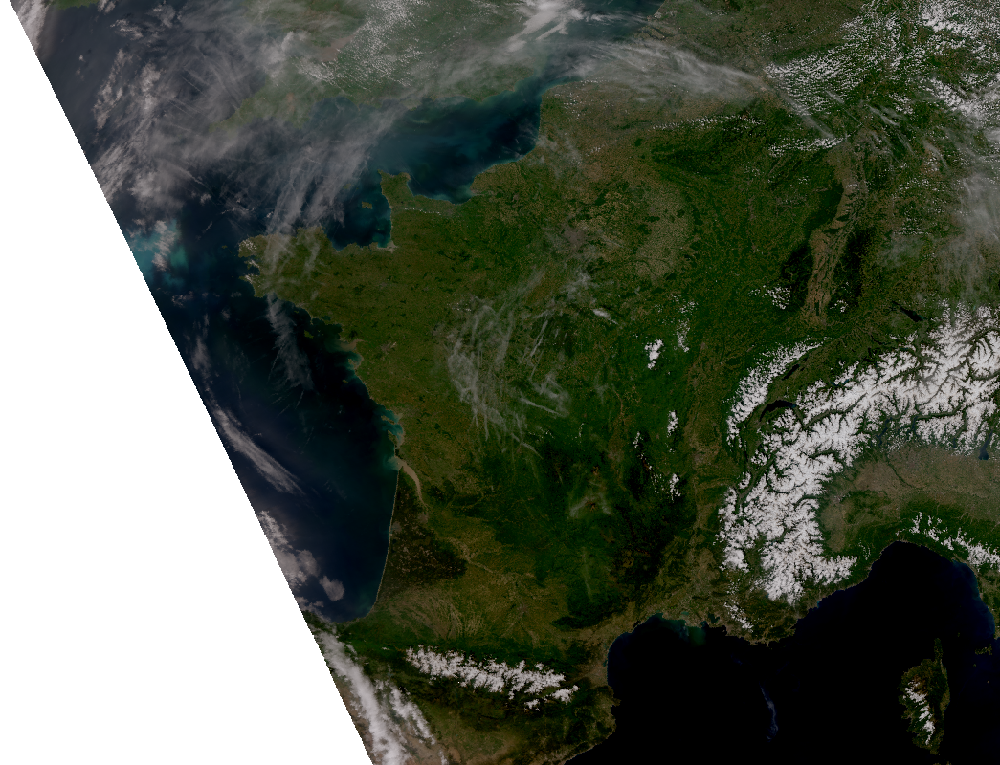

In [39]:
new_scn.show(
    "true_color",
    # {
    #     "coast_dir": "/Users/xo/satpy/gshhg-shp-2.3.7",
    #     "color": (255, 255, 0),
    #     "resolution": "i",
    # },
)

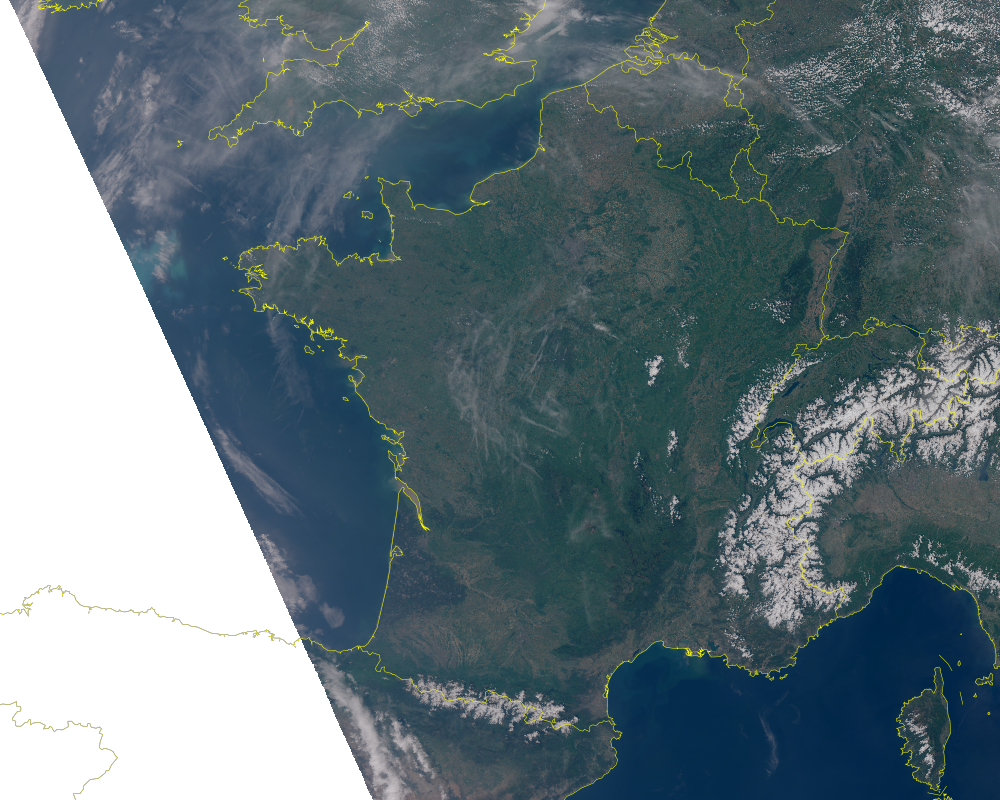

In [10]:
new_scn.show(
    "true_color_raw",
    {
        "coast_dir": "/Users/xo/Documents/data/gshhg-shp-2.3.7",
        "color": (255, 255, 0),
        "resolution": "i",
    },
)
